# Building process models in pywatershed

*James McCreight, USGS/UCAR*

## Introduction 

It is a major scientific challenge to simulate and predict water quantity and quality in the environment. Over the years, many analytical, numerical, and statistical approaches have been developed to address this problem. The choice of modeling approaches often depends on specific real-world problems, resulting in a wide variation of models across different applications.

The United States Geological Survey (USGS), among others, has an important legacy of models for simulating water quantity and quality in the environment. The USGS is also building new models for emerging applications. To enhance their effectiveness, it is crucial to establish interoperability of existing and future models. The Enterprise Capacity (EC) project at the USGS aims to create flexible, reusable, and interoperable models that can support water quantity and quality modeling across a broad range of applications.

Focusing on water quantity, this notebook highlights on-going development to redesign core USGS hydrologic simulation capabilities into a modular and interoperable Python package. The goal of this package is to support flexible representations of conceptual process models and hypothesis testing of model suitability for a given application. 

The USGS National Hydrologic Model (NHM, Regan et al., 2018) is a specific, national-scale instance of certain physical process models in the Precipitation-Runoff Modeling System (PRMS, Regan et al., 2015). The PRMS concepts used in the NHM have been expressed in the Python package `pywatershed`. In this notebook, we demonstrate modeling of the Delaware River Basin (DRB) subdomain of the NHM for a 2 year period.

The goal of this notebook is to demonstrate the use of pywatershed for interested users, highlighting its modularity and its self-describing nature. The outline of this notebook is as follows:

1. **NHM in pywatershed:** We from atmospheric forcings/inputs and show how the model is designed at a conceptual process level
2. **Submodels in pywatershed:** We demonstrate modularity by isolating and executing a submodel of the full NHM model.
3. **Zooming in:** We delve into greater detial on how to query and control the model and its execution. 

## Results

### Requirements:
The conda environment specified in pws-env.yml is what is required to run this notebook.

In [1]:
%load_ext jupyter_black

In [2]:
import pathlib as pl
from pprint import pprint
import urllib
import zipfile

import pywatershed as pws
import xarray as xr

root_dir = pl.Path("./process_models").resolve()

In [3]:
gis_dir = root_dir / "pywatershed_gis"
if not gis_dir.exists():
    gis_url = "https://github.com/EC-USGS/pywatershed/releases/download/v2022.0.1/pynhm_gis.zip"
    gis_file = root_dir / "pynhm_gis.zip"
    urllib.request.urlretrieve(gis_url, gis_file)

    with zipfile.ZipFile(gis_file, "r") as zz:
        zz.extractall(root_dir)

    (root_dir / "pynhm_gis").rename(gis_dir)

In [4]:
domain_dir = root_dir / "drb_2yr"
domain_gis_dir = gis_dir / "drb_2yr"

### Full NHM configuration for the Delaware River Basin

In [5]:
nhm_output_dir = root_dir / "model_runs/nhm"

In [6]:
params = pws.parameters.PrmsParameters.load(domain_dir / "myparam.param")
control = pws.Control.load(domain_dir / "control.test", params=params)

nhm = pws.Model(
    pws.PRMSSolarGeometry,
    pws.PRMSAtmosphere,
    pws.PRMSCanopy,
    pws.PRMSSnow,
    pws.PRMSRunoff,
    pws.PRMSSoilzone,
    pws.PRMSGroundwater,
    pws.PRMSChannel,
    control=control,
    input_dir=domain_dir,
    budget_type="warn",
    verbose=True,
    calc_method="numba",
)
nhm.initialize_netcdf(output_dir=nhm_output_dir)

In [7]:
%%time
nhm.run(finalize=True)

model.run(): 0 % complete
PRMSCanopy jit compiling with numba 
PRMSSnow jit compiling with numba 
PRMSRunoff jit compiling with numba 
PRMSSoilzone jit compiling with numba 
PRMSGroundwater jit compiling with numba 
PRMSChannel jit compiling with numba 
Wrote file: /Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/model_runs/nhm/soltab_horad_potsw.nc
Wrote file: /Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/model_runs/nhm/soltab_potsw.nc
Wrote file: /Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/model_runs/nhm/soltab_sunhrs.nc
Wrote file: /Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/model_runs/nhm/tmaxf.nc
Wrote file: /Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/model_runs/nhm/tminf.nc
Wrote file: /Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/model_runs/nhm/prmx.nc
Wrote file: /Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/model_runs/nhm/hru_ppt.nc
Wrote file: /Users/jmccreight/usgs/pyw

/Users/jmccreight/usgs/pywatershed/pywatershed/base/budget.py:316: UserWarning: The flux unit balance not equal to the change in unit storage: PRMSSnow
  warn(msg, UserWarning)
/Users/jmccreight/usgs/pywatershed/pywatershed/base/budget.py:316: UserWarning: The flux unit balance not equal to the change in unit storage: PRMSRunoff
  warn(msg, UserWarning)


model.run(): 10 % complete
model.run(): 20 % complete
model.run(): 30 % complete
model.run(): 40 % complete
model.run(): 50 % complete
model.run(): 60 % complete
model.run(): 70 % complete
model.run(): 80 % complete
model.run(): 90 % complete
model.run(): 100 % complete
model.run(): finalizing
CPU times: user 30 s, sys: 1.03 s, total: 31.1 s
Wall time: 32.9 s


When the model starts, we see a pause while the message "process jit compiling with numba" is printed. For each process listed, this is when the numba just-in-time (jit) compiler compiles the code for the process representation. The processes that benefit from jit compiling are challenging to vectorize and have a loop over space which is accelerated by the compiling. The remaining processes, not jit compiled, are all vectorized: PRMSSolarGeometry, PRMSAtmosphere. In fact, because these two processes are strictly pre-processing between input files and the rest of the model (all their input is know in advance), they are both vectorized in space and time. This is why all the variables are written out before the rest of the model runs.  

A note on PRMSGroundwater is that it is both vectorized and jit-compiled. The numba, jit-compiled code is only slightly slower so it has not been removed.

/Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/process_plot.py:46: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  self.seg_gdf.explode()
/Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/process_plot.py:63: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  hru_geoms_exploded = self.hru_gdf.explode().reset_index(level=1, drop=True)
/Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/process_plot.py:101: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  hru_poly = plot_polygon_collection(
/Users/jmccreight/anacon

None

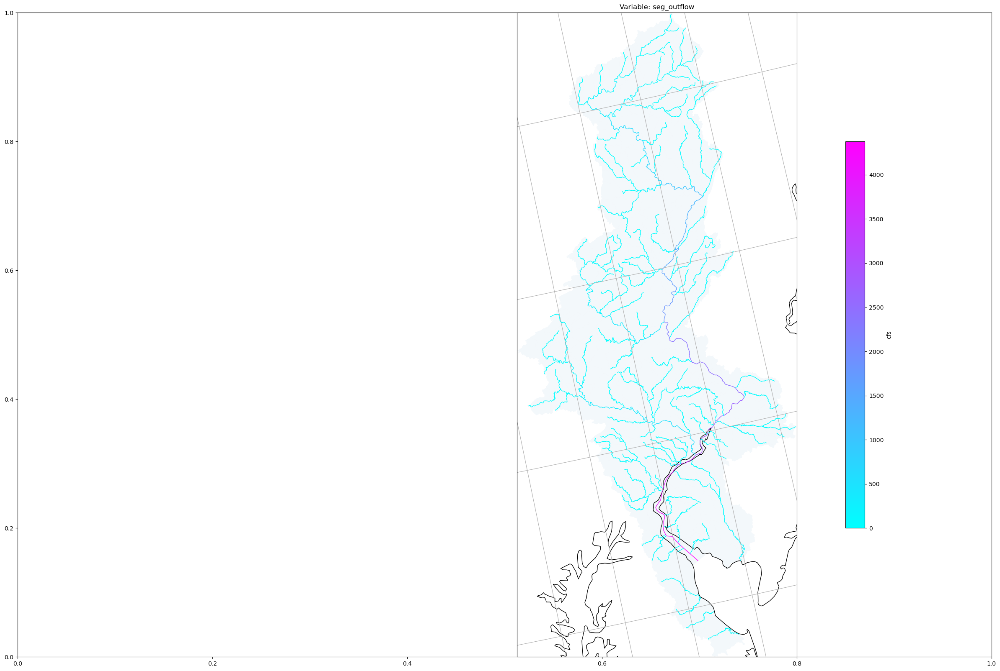

In [8]:
from process_models import process_plot

proc_plot = process_plot.ProcessPlot(domain_gis_dir)

proc_name = "PRMSChannel"
var_name = "seg_outflow"
proc = nhm.processes[proc_name]
display(proc_plot.plot_seg_var(var_name, proc))

Displaying SVG written to temp file: /var/folders/9l/7ch3kq7d1b10mc6fr99rd_n56cxk0f/T/tmps998kcb9


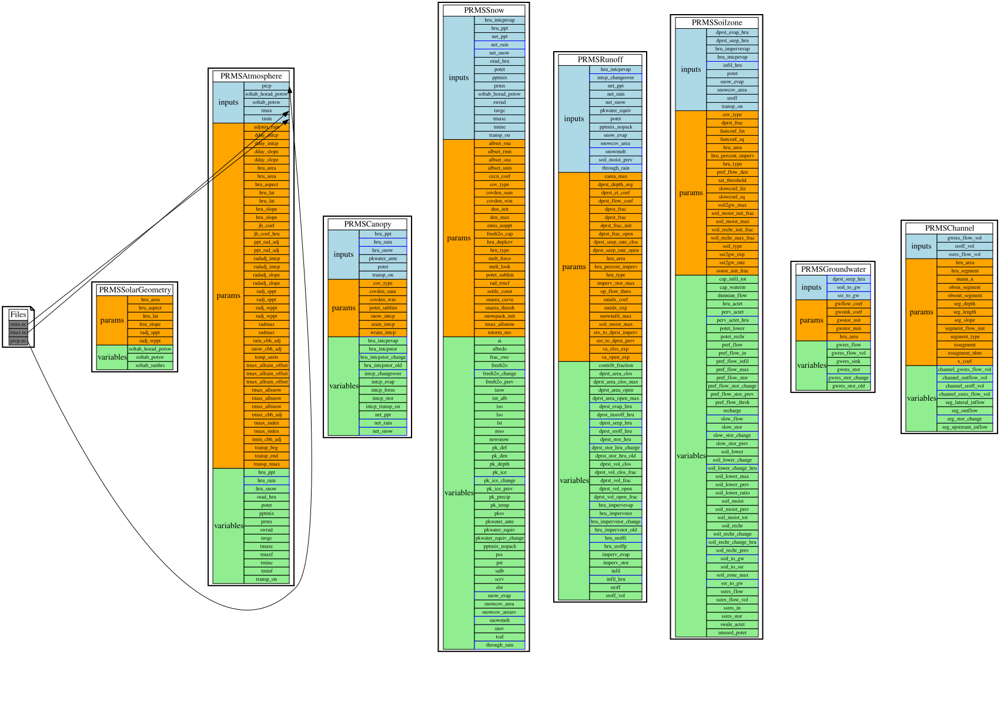

In [9]:
pws.analysis.ModelGraph(nhm, hide_variables=False, show_params=True).SVG(verbose=True)

### NHM Submodel for the Delaware River Basin 
Suppose you wanted to change parameters or model process representation in the PRMSSoilzone to better predict streamflow. As the model is 1-way coupled, you can simply run a submodel starting with PRMSSoilzone and running through PRMSChannel.

In [10]:
# what is our submodel?
submodel_processes = [pws.PRMSSoilzone, pws.PRMSGroundwater, pws.PRMSChannel]

In [11]:
# what are the inputs for our sub model?

In [12]:
submodel_input_dict = {pp.__name__: pp.get_inputs() for pp in submodel_processes}
pprint(submodel_input_dict)

{'PRMSChannel': ('sroff_vol', 'ssres_flow_vol', 'gwres_flow_vol'),
 'PRMSGroundwater': ('soil_to_gw', 'ssr_to_gw', 'dprst_seep_hru'),
 'PRMSSoilzone': ('dprst_evap_hru',
                  'dprst_seep_hru',
                  'hru_impervevap',
                  'hru_intcpevap',
                  'infil_hru',
                  'sroff',
                  'potet',
                  'transp_on',
                  'snow_evap',
                  'snowcov_area')}


In [13]:
submodel_vars_dict = {pp.__name__: pp.get_variables() for pp in submodel_processes}
pprint(submodel_vars_dict)

{'PRMSChannel': ['channel_sroff_vol',
                 'channel_ssres_flow_vol',
                 'channel_gwres_flow_vol',
                 'channel_outflow_vol',
                 'seg_lateral_inflow',
                 'seg_upstream_inflow',
                 'seg_outflow',
                 'seg_stor_change'],
 'PRMSGroundwater': ['gwres_flow',
                     'gwres_flow_vol',
                     'gwres_sink',
                     'gwres_stor',
                     'gwres_stor_old',
                     'gwres_stor_change'],
 'PRMSSoilzone': ['cap_infil_tot',
                  'cap_waterin',
                  'dunnian_flow',
                  'hru_actet',
                  'perv_actet',
                  'perv_actet_hru',
                  'potet_lower',
                  'potet_rechr',
                  'pref_flow',
                  'pref_flow_in',
                  'pref_flow_infil',
                  'pref_flow_max',
                  'pref_flow_stor',
                  'pre

In [14]:
# whic of these are not in variables?

In [15]:
submodel_inputs = set([ii for tt in submodel_input_dict.values() for ii in tt])
submodel_variables = set([ii for tt in submodel_vars_dict.values() for ii in tt])
submodel_file_inputs = tuple(submodel_inputs - submodel_variables)
pprint(submodel_file_inputs)

('snow_evap',
 'snowcov_area',
 'hru_intcpevap',
 'potet',
 'transp_on',
 'sroff',
 'dprst_evap_hru',
 'sroff_vol',
 'dprst_seep_hru',
 'infil_hru',
 'hru_impervevap')


In [16]:
# where will we get these?
for ii in submodel_file_inputs:
    assert (nhm_output_dir / f"{ii}.nc").exists()

The `Model` object basically does the above so you dont have to. The wiring and looking for input data is based on the publically availably information on each process model. Let's run our submodel.

In [17]:
## plot the model diagram
submodel_output_dir = root_dir / "model_runs/submodel"
params = pws.parameters.PrmsParameters.load(domain_dir / "myparam.param")  # fix this
control = pws.Control.load(domain_dir / "control.test", params=params)

submodel = pws.Model(
    *submodel_processes,
    control=control,
    input_dir=nhm_output_dir,
    budget_type="warn",
    calc_method="numba",
)

In [18]:
# pws.analysis.ModelGraph(submodel, hide_variables=False, show_params=True).SVG(verbose=True)

In [19]:
submodel.initialize_netcdf(output_dir=submodel_output_dir)

In [20]:
%%time
submodel.run(finalize=True)

model.run(): 0 % complete
PRMSSoilzone jit compiling with numba 
PRMSGroundwater jit compiling with numba 
PRMSChannel jit compiling with numba 
model.run(): 10 % complete
model.run(): 20 % complete
model.run(): 30 % complete
model.run(): 40 % complete
model.run(): 50 % complete
model.run(): 60 % complete
model.run(): 70 % complete
model.run(): 80 % complete
model.run(): 90 % complete
model.run(): 100 % complete
model.run(): finalizing
CPU times: user 12.9 s, sys: 347 ms, total: 13.3 s
Wall time: 13.3 s


The final time is still in memory. We can take a look at, say, recharge.

In [21]:
print("PRMSSoilzone dimension names: ", submodel.processes["PRMSSoilzone"].dimensions)
print("nhru: ", submodel.processes["PRMSSoilzone"].nhru)
print(
    "PRMSSoilzone recharge shape: ",
    submodel.processes["PRMSSoilzone"]["recharge"].shape,
)

PRMSSoilzone dimension names:  ('nhru', 'nssr')
nhru:  765
PRMSSoilzone recharge shape:  (765,)


There is only a spatial dimension, but the last time is still in memory (even though we've finalized the run). 

In [22]:
## Get the GIS information using curl
proc_plot = process_plot.ProcessPlot(domain_gis_dir)

proc_name = "PRMSSoilzone"
var_name = "recharge"
proc = submodel.processes[proc_name]
display(proc_plot.plot_hru_var(var_name, proc))

/Users/jmccreight/usgs/pywatershed-csdms-2023/process_models/process_plot.py:46: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  self.seg_gdf.explode()


:Overlay
   .Tiles.I    :Tiles   [x,y]
   .Polygons.I :Polygons   [Longitude,Latitude]   (recharge)

We can easily check the results of our submodel model against our full model. This gives us an opportunity to look at the output files. We can start with recharge as our variable of interest

In [23]:
var = "recharge"
nhm_ds = xr.open_dataset(nhm_output_dir / f"{var}.nc")
sub_ds = xr.open_dataset(submodel_output_dir / f"{var}.nc")

In [24]:
display(nhm_ds)
display(sub_ds)

<xarray.Dataset>
Dimensions:   (time: 731, nhm_id: 765)
Coordinates:
  * time      (time) datetime64[ns] 1979-01-01 1979-01-02 ... 1980-12-31
  * nhm_id    (nhm_id) int32 5307 5308 5309 5310 5311 ... 7248 7249 7250 7251
Data variables:
    recharge  (time, nhm_id) float64 ...
Attributes:
    Description:  PYNHM output data

<xarray.Dataset>
Dimensions:   (time: 731, nhm_id: 765)
Coordinates:
  * time      (time) datetime64[ns] 1979-01-01 1979-01-02 ... 1980-12-31
  * nhm_id    (nhm_id) int32 5307 5308 5309 5310 5311 ... 7248 7249 7250 7251
Data variables:
    recharge  (time, nhm_id) float64 ...
Attributes:
    Description:  PYNHM output data

If you expand the metadata (the little folded page icon on the right side of the recharge line), you get a variable description, dimension, type, and units. 

Now compare all output variables common to both runs.

In [25]:
for var in submodel_variables:
    nhm_da = xr.open_dataset(nhm_output_dir / f"{var}.nc")[var]
    sub_da = xr.open_dataset(submodel_output_dir / f"{var}.nc")[var]
    xr.testing.assert_equal(nhm_da, sub_da)

### Zooming in, in pywatershed

For illustrative purposes, say you are interested some of the details of the groundwater representation in the above submodel. For a start, you can ask that class for its description. It returns a dictionary with the top-level keys: `class_name`, `inputs`, `mass_budget_terms`, `parameters`, and `variables`. For `inputs`, `parameters`, and `variables`, the corresponding value is a dictionary of metadata about the data in each of those categories. For `mass_budget_terms`, the data involved in the calculation of the budgets are summarized in terms of `inputs`, `outputs`, and `storage_changes`. It is easy to quickly get oriented to the model via this description. 

In [26]:
pprint(pws.PRMSGroundwater.description())

{'class_name': 'PRMSGroundwater',
 'inputs': {'dprst_seep_hru': {'desc': 'Seepage from surface-depression '
                                       'storage to associated GWR for each HRU',
                               'dims': ('nhru',),
                               'type': 'float64',
                               'units': 'inches',
                               'var_category': 'mass flux'},
            'soil_to_gw': {'desc': 'Portion of excess flow to the capillary '
                                   'reservoir that drains to the associated '
                                   'GWR for each HRU',
                           'dims': ('nhru',),
                           'type': 'float64',
                           'units': 'inches',
                           'var_category': 'mass flux'},
            'ssr_to_gw': {'desc': 'Drainage from the gravity-reservoir to the '
                                  'associated GWR for each HRU',
                          'dims': ('nssr',),
    

Next, lets say we are interested in looking at certain variables in real time, as the model runs. We'll pull apart the time advance loop.

In [27]:
## plot the model diagram
submodel_output_dir = root_dir / "model_runs/submodel"
params = pws.parameters.PrmsParameters.load(domain_dir / "myparam.param")  # fix this
control = pws.Control.load(domain_dir / "control.test", params=params)

submodel = pws.Model(
    *submodel_processes,
    control=control,
    input_dir=nhm_output_dir,
    budget_type="warn",
    calc_method="numpy",
)

In [28]:
for tt in list(range(control.n_times))[0:3]:
    print("time step: ", tt)
    submodel.advance()
    print("timestep start time: ", control.current_time)
    submodel.calculate()
    print("mean gwres_stor: ", submodel.processes["PRMSGroundwater"].gwres_stor.mean())

time step:  0
timestep start time:  1979-01-01T00:00:00
mean gwres_stor:  1.9701848319690527
time step:  1
timestep start time:  1979-01-02T00:00:00
mean gwres_stor:  1.966403971446863
time step:  2
timestep start time:  1979-01-03T00:00:00
mean gwres_stor:  1.9318833998423692


In [29]:
submodel.processes["PRMSGroundwater"].budget

*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
Individual spatial unit budget for PRMSGroundwater (units: inches).
Budget is checked on each spatial unit. This is summary shows
spatial sums for the entire model domain.

@ time: 1979-01-03T00:00:00 (itime_step: 2)

This timestep, rates:
         input rates                   output rates              storage change rates         
         --------------------------    ----------------------    -----------------------------
         soil_to_gw: 1.49782728e-04    gwres_flow: 3.5435e+01    gwres_stor_change: -2.641e+01        
         ssr_to_gw: 3.708446038e+00                                                                   
         dprst_seep_hru: 5.3183e+00                                                                   
         -------------------------------------------------------------------------------------
Balance:                 9.0269e+00    -           3.5435e+01    =     

## Conclusions

This notebook demonstrates the capabilities of `pywatershed` to flexibly model process representations in a way that is friendly to both users and developers.  


## References
* Regan, R. S., Markstrom, S. L., Hay, L. E., Viger, R. J., Norton, P. A., Driscoll, J. M., & LaFontaine, J. H. (2018). Description of the national hydrologic model for use with the precipitation-runoff modeling system (prms) (No. 6-B9). US Geological Survey.
* Regan, R.S., Markstrom, S.L., LaFontaine, J.H., 2022, PRMS version 5.2.1: Precipitation-Runoff Modeling System (PRMS): U.S. Geological Survey Software Release, 02/10/2022.
